In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from copy import copy
from scipy import stats
import plotly.express as px
import plotly.figure_factory as ff
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from tensorflow import keras

In [2]:
# Reading the stock data csv file, here's the list of the stocks considered:

# AAPL = Apple Stock 
# BA = Boeing 
# T = AT&T
# MGM = MGM Resorts International (Hotel Industry)
# AMZN = Amazon
# IBM = IBM
# TSLA = Tesla Motors
# GOOG = Google 
# sp500 = US Stock Market (S&P 500 is a stock market index that measures the stock performance of 500 large companies listed on U.S. stock exchange)
# Check the list of S&P 500 companies here: https://en.wikipedia.org/wiki/List_of_S%26P_500_companies

stocks_df = pd.read_csv('stock.csv')
stocks_df.head()

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.13,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.35,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.25,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.73,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.80,194.449997,180.520004,26.760000,318.590851,1314.500000


In [3]:
stocks_df.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000
mean,140.819823,189.942700,35.162899,23.105743,915.665665,161.853001,259.600815,783.712512,2218.749554
std,70.827601,103.678586,3.207490,6.963847,697.838905,25.561938,210.988003,334.448057,537.321727
min,55.790001,67.239998,26.770000,7.140000,175.929993,94.769997,22.790001,278.481171,1278.040039
25%,89.165714,124.015000,33.040001,18.545000,316.490005,142.769997,184.595001,527.214416,1847.984985
50%,116.599998,142.419998,34.930000,23.780001,676.010010,156.949997,231.960007,737.599976,2106.629883
75%,175.019997,297.044998,37.419998,28.430000,1593.645019,185.974998,307.350006,1079.744995,2705.810059
max,455.609985,440.619995,43.470001,38.029999,3225.000000,215.800003,1643.000000,1568.489990,3386.149902


In [4]:
stocks_df = stocks_df.sort_values(by = ['Date'])
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [5]:
print("Total Number of Stocks - ", len(stocks_df.columns[1:]))

Total Number of Stocks -  9


In [6]:
print('Stocks under consideration are:')
for i in stocks_df.columns[1:]:
  print(i)

Stocks under consideration are:
AAPL
BA
T
MGM
AMZN
IBM
TSLA
GOOG
sp500


# PERFORMING EXPLORATORY DATA ANALYSIS AND BASIC VISUALIZATION

In [7]:
# Check if data contains any null values
stocks_df.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [8]:
# Getting dataframe info
stocks_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2159 non-null   object 
 1   AAPL    2159 non-null   float64
 2   BA      2159 non-null   float64
 3   T       2159 non-null   float64
 4   MGM     2159 non-null   float64
 5   AMZN    2159 non-null   float64
 6   IBM     2159 non-null   float64
 7   TSLA    2159 non-null   float64
 8   GOOG    2159 non-null   float64
 9   sp500   2159 non-null   float64
dtypes: float64(9), object(1)
memory usage: 185.5+ KB


In [9]:
# Defining a function to plot the entire dataframe
# The function takes in a dataframe df as an input argument and does not return anything back!
# The function performs data visualization

def show_plot(df, fig_title):
  df.plot(x = 'Date', figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()

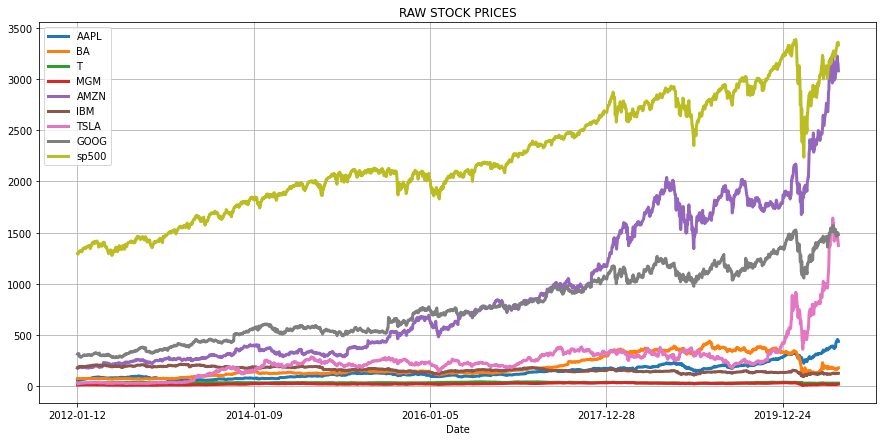

In [10]:
# Plot the data
show_plot(stocks_df, 'RAW STOCK PRICES')

In [11]:
#Normalizing our Dataset for a better Picture

def Normalize(df):
    x = df.copy()
    for i in x.columns[1:]:
        x[i] = x[i]/x[i][0]
    return x

In [12]:
Normalize(stocks_df)

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2012-01-13,0.996251,0.987949,0.998340,1.018137,1.014153,0.992301,0.806726,0.992615,0.995052
2,2012-01-17,1.007855,0.996424,1.004316,1.009893,1.032570,0.996954,0.941593,0.998317,0.998587
3,2012-01-18,1.018320,0.994040,1.006972,1.049464,1.076792,1.002880,0.949027,1.005193,1.009680
4,2012-01-19,1.015093,1.000662,1.009960,1.055235,1.105269,0.999834,0.947257,1.015771,1.014666
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,7.313297,2.308039,0.991036,1.378401,18.217644,0.694821,52.567080,4.698347,2.568715
2155,2020-08-06,7.568452,2.280493,0.990704,1.521847,18.331155,0.698532,52.728494,4.782805,2.585226
2156,2020-08-07,7.383066,2.251622,0.996680,1.568838,18.004093,0.692107,51.423361,4.764919,2.586862
2157,2020-08-10,7.490377,2.375977,1.002656,1.784831,17.894390,0.704016,50.214865,4.770052,2.593956


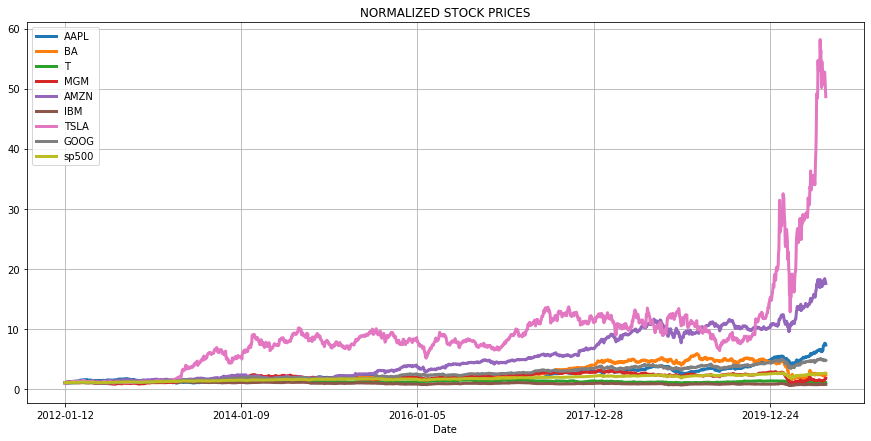

In [13]:
show_plot(Normalize(stocks_df), 'NORMALIZED STOCK PRICES')

### As we can notice, over the years TESLA has been the most profitable stock for the Investors so far followed by Amazon.
### Also we can notice that stock value of IBM has decreased over time.

# PERFORMING INTERACTIVE DATA VISUALISATION

In [14]:
# Function to perform an interactive data plotting using plotly express 

def interactive_plot(df, title):
  fig = px.line(title = title)
  
  # Loop through each stock (while ignoring time columns with index 0 (date))
  for i in df.columns[1:]:
    fig.add_scatter(x = df['Date'], y = df[i], name = i) # add a new Scatter trace

  fig.show()

In [15]:
# Plotting Interactive Chart
interactive_plot(stocks_df, 'Prices')

In [16]:
# Plotting Normalized Interactive Chart
interactive_plot(Normalize(stocks_df), 'Normalized Prices')

In [17]:
#calculating daily return of various Stocks
daily_return = stocks_df.copy()

for i in stocks_df.columns[1:]:
    for j in range(1, len(stocks_df)):
        daily_return[i][j]=((stocks_df[i][j]-stocks_df[i][j-1])/stocks_df[i][j-1])*100
    daily_return[i][0]=0
        
daily_return        

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.374946,-1.205144,-0.166006,1.813685,1.415339,-0.769869,-19.327430,-0.738516,-0.494792
2,2012-01-17,1.164812,0.857909,0.598603,-0.809717,1.815943,0.468852,16.717854,0.574410,0.355295
3,2012-01-18,1.038382,-0.239234,0.264463,3.918367,4.282725,0.594448,0.789470,0.688856,1.110793
4,2012-01-19,-0.316937,0.666134,0.296736,0.549882,2.644634,-0.303752,-0.186494,1.052283,0.493866
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.362467,5.579446,-0.533156,0.000000,2.109065,-0.309917,-0.133153,0.589774,0.642974
2155,2020-08-06,3.488923,-1.193483,-0.033501,10.406699,0.623082,0.534082,0.307062,1.797626,0.642770
2156,2020-08-07,-2.449458,-1.265966,0.603217,3.087768,-1.784187,-0.919762,-2.475194,-0.373974,0.063303
2157,2020-08-10,1.453480,5.522880,0.599604,13.767729,-0.609323,1.720552,-2.350092,0.107728,0.274222


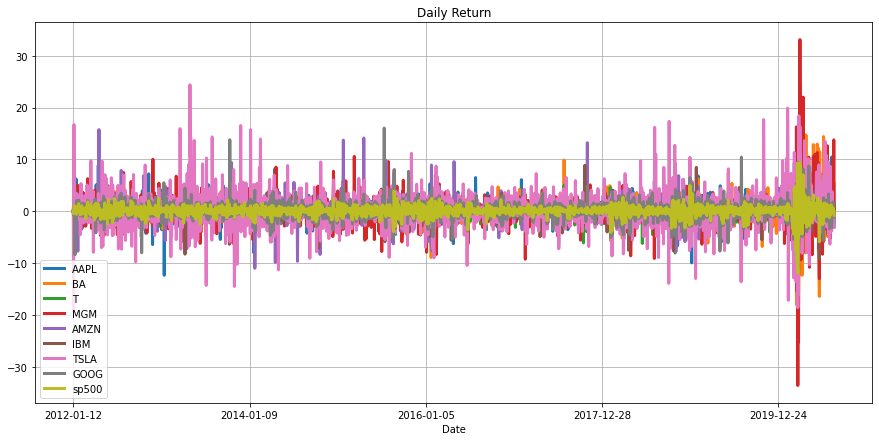

In [18]:
show_plot(daily_return, 'Daily Return')

In [19]:
interactive_plot(daily_return, 'Daily Return of Stocks')

In [20]:
#Maximum Daily Return of Stocks
for i in daily_return.columns[1:]:
    print(i, ' - ', max(daily_return[i]))

AAPL  -  11.980826442909029
BA  -  24.318605889724303
T  -  10.022345994254724
MGM  -  33.11475409836065
AMZN  -  15.745701419824961
IBM  -  11.301051323236818
TSLA  -  24.395054232029867
GOOG  -  16.052430948104412
sp500  -  9.382773987446068


# CALCULATING THE CORRELATIONS BETWEEN DAILY RETURNS

In [21]:
# Daily Return Correlation
cm = daily_return.drop(columns = ['Date']).corr()

<AxesSubplot:>

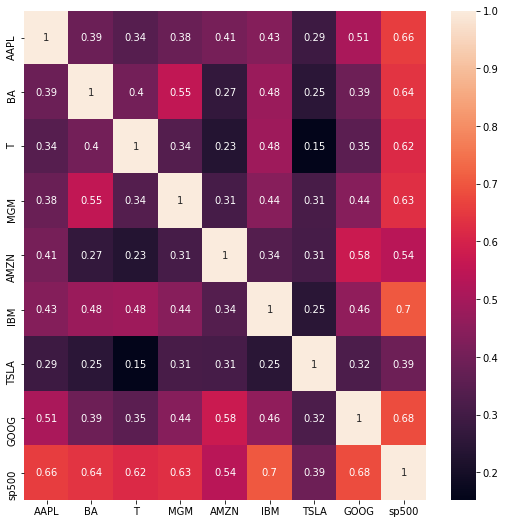

In [22]:
plt.figure(figsize=(9, 9))
sns.heatmap(cm, annot=True)

In [23]:
cm

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
AAPL,1.000000,0.385250,0.341373,0.384089,0.410234,0.434534,0.288535,0.509125,0.657321
BA,0.385250,1.000000,0.401602,0.554229,0.267466,0.479264,0.250946,0.388048,0.641826
T,0.341373,0.401602,1.000000,0.340166,0.233145,0.484219,0.152515,0.353695,0.617463
MGM,0.384089,0.554229,0.340166,1.000000,0.309016,0.441631,0.311879,0.439142,0.631449
AMZN,0.410234,0.267466,0.233145,0.309016,1.000000,0.339589,0.310084,0.575284,0.539560
IBM,0.434534,0.479264,0.484219,0.441631,0.339589,1.000000,0.245609,0.458816,0.703935
TSLA,0.288535,0.250946,0.152515,0.311879,0.310084,0.245609,1.000000,0.322805,0.387921
GOOG,0.509125,0.388048,0.353695,0.439142,0.575284,0.458816,0.322805,1.000000,0.684572
sp500,0.657321,0.641826,0.617463,0.631449,0.539560,0.703935,0.387921,0.684572,1.000000


# PLOTTING THE HISTOGRAM FOR DAILY RETURNS

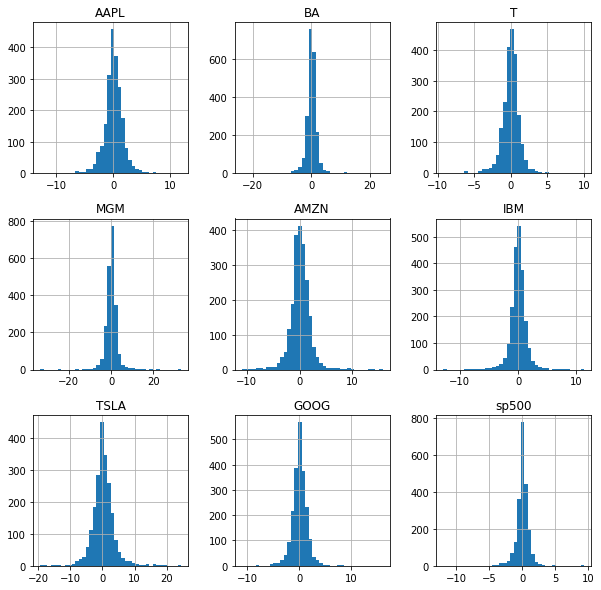

In [24]:
# Histogram of daily returns
# Stock returns are normally distributed with zero mean 
# Notice how Tesla Standard deviation is high indicating a more volatile stock
daily_return.hist(figsize=(10, 10), bins = 40);

In [25]:
# Group all data returns together in a list

data = []

for i in daily_return.columns[1:]:
  data.append(daily_return[i].values)
data

[array([ 0.        , -0.37494578,  1.16481192, ..., -2.44945751,
         1.45347999, -2.9739868 ]),
 array([ 0.        , -1.20514366,  0.85790887, ..., -1.26596576,
         5.52287953,  0.40131597]),
 array([ 0.        , -0.16600597,  0.59860326, ...,  0.60321716,
         0.5996036 ,  0.        ]),
 array([ 0.        ,  1.81368508, -0.8097166 , ...,  3.08776831,
        13.76772918, -0.69284065]),
 array([ 0.        ,  1.41533854,  1.8159433 , ..., -1.78418726,
        -0.60932259, -2.14379167]),
 array([ 0.        , -0.76986928,  0.46885241, ..., -0.91976211,
         1.72055219, -0.28322004]),
 array([  0.        , -19.32743009,  16.71785359, ...,  -2.47519409,
         -2.35009162,  -3.1143992 ]),
 array([ 0.        , -0.73851634,  0.57441015, ..., -0.37397414,
         0.10772812, -1.05474435]),
 array([ 0.        , -0.49479228,  0.35529545, ...,  0.06330295,
         0.27422185, -0.79691324])]

In [26]:
# Notice how Boeing, Tesla and MGM gains are losses are sometimes extreme! This will indicate a more risky investment and will be quantified later using Sharpe Ratio
fig = ff.create_distplot(data, daily_return.columns[1:])
fig.show()

In [27]:
np.random.seed(101)
weights = np.array(np.random.random(9))
weights = weights / np.sum(weights) 
print(weights)

[0.10921307 0.12069041 0.00602201 0.03627509 0.14492913 0.17636073
 0.06492024 0.1889901  0.15259921]


In [28]:
df_portfolio = Normalize(stocks_df)
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2012-01-13,0.996251,0.987949,0.998340,1.018137,1.014153,0.992301,0.806726,0.992615,0.995052
2,2012-01-17,1.007855,0.996424,1.004316,1.009893,1.032570,0.996954,0.941593,0.998317,0.998587
3,2012-01-18,1.018320,0.994040,1.006972,1.049464,1.076792,1.002880,0.949027,1.005193,1.009680
4,2012-01-19,1.015093,1.000662,1.009960,1.055235,1.105269,0.999834,0.947257,1.015771,1.014666
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,7.313297,2.308039,0.991036,1.378401,18.217644,0.694821,52.567080,4.698347,2.568715
2155,2020-08-06,7.568452,2.280493,0.990704,1.521847,18.331155,0.698532,52.728494,4.782805,2.585226
2156,2020-08-07,7.383066,2.251622,0.996680,1.568838,18.004093,0.692107,51.423361,4.764919,2.586862
2157,2020-08-10,7.490377,2.375977,1.002656,1.784831,17.894390,0.704016,50.214865,4.770052,2.593956


In [29]:
for i in range(0, len(df_portfolio)):
    p = 0
    for j in df_portfolio.columns[1:]:
        df_portfolio[j][i] = df_portfolio[j][i] * weights[p] * (10**5)
        p = p+1
        
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,10921.307297,12069.040749,602.201014,3627.509089,14492.913224,17636.072991,6492.024252,18899.010423,15259.920960
1,2012-01-13,10880.358316,11923.591470,601.201325,3693.300680,14698.037011,17500.298284,5237.282803,18759.438143,15184.416049
2,2012-01-17,11007.094026,12025.885019,604.800135,3663.395412,14964.945030,17582.348854,6112.844074,18867.194259,15238.365588
3,2012-01-18,11121.389674,11997.114958,606.399607,3806.940701,15605.852438,17686.866834,6161.103140,18997.162068,15407.632271
4,2012-01-19,11086.141859,12077.031793,608.199012,3827.874389,16018.570142,17633.142697,6149.613061,19197.065903,15483.725281
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,79870.760010,27855.811865,596.802778,5000.160622,264026.737567,12253.920061,341266.760516,88794.100361,39198.384776
2155,2020-08-06,82657.389597,27523.357512,596.602844,5520.512297,265671.841121,12319.366057,342314.661936,90390.285881,39450.340053
2156,2020-08-07,80632.731958,27174.921230,600.201655,5690.972926,260931.757989,12206.057196,333841.709663,90052.249585,39475.313282
2157,2020-08-10,81804.712585,28675.759392,603.800486,6474.490666,259341.841849,12416.068780,325996.123633,90149.261183,39583.563215


In [30]:
df_portfolio['Portfolio Daily Worth'] = df_portfolio[df_portfolio != 'Date'].sum(axis = 1)
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,Portfolio Daily Worth
0,2012-01-12,10921.307297,12069.040749,602.201014,3627.509089,14492.913224,17636.072991,6492.024252,18899.010423,15259.920960,100000.000000
1,2012-01-13,10880.358316,11923.591470,601.201325,3693.300680,14698.037011,17500.298284,5237.282803,18759.438143,15184.416049,98477.924080
2,2012-01-17,11007.094026,12025.885019,604.800135,3663.395412,14964.945030,17582.348854,6112.844074,18867.194259,15238.365588,100066.872398
3,2012-01-18,11121.389674,11997.114958,606.399607,3806.940701,15605.852438,17686.866834,6161.103140,18997.162068,15407.632271,101390.461691
4,2012-01-19,11086.141859,12077.031793,608.199012,3827.874389,16018.570142,17633.142697,6149.613061,19197.065903,15483.725281,102081.364139
...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,79870.760010,27855.811865,596.802778,5000.160622,264026.737567,12253.920061,341266.760516,88794.100361,39198.384776,858863.438557
2155,2020-08-06,82657.389597,27523.357512,596.602844,5520.512297,265671.841121,12319.366057,342314.661936,90390.285881,39450.340053,866444.357297
2156,2020-08-07,80632.731958,27174.921230,600.201655,5690.972926,260931.757989,12206.057196,333841.709663,90052.249585,39475.313282,850605.915485
2157,2020-08-10,81804.712585,28675.759392,603.800486,6474.490666,259341.841849,12416.068780,325996.123633,90149.261183,39583.563215,845045.621789


In [31]:
df_portfolio['portfolio daily % return'] = 0.0000

for i in range(1, len(stocks_df)):
  # Calculate the percentage of change from the previous day
  df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['Portfolio Daily Worth'][i] - df_portfolio['Portfolio Daily Worth'][i-1]) / df_portfolio['Portfolio Daily Worth'][i-1]) * 100 

df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,Portfolio Daily Worth,portfolio daily % return
0,2012-01-12,10921.307297,12069.040749,602.201014,3627.509089,14492.913224,17636.072991,6492.024252,18899.010423,15259.920960,100000.000000,0.000000
1,2012-01-13,10880.358316,11923.591470,601.201325,3693.300680,14698.037011,17500.298284,5237.282803,18759.438143,15184.416049,98477.924080,-1.522076
2,2012-01-17,11007.094026,12025.885019,604.800135,3663.395412,14964.945030,17582.348854,6112.844074,18867.194259,15238.365588,100066.872398,1.613507
3,2012-01-18,11121.389674,11997.114958,606.399607,3806.940701,15605.852438,17686.866834,6161.103140,18997.162068,15407.632271,101390.461691,1.322705
4,2012-01-19,11086.141859,12077.031793,608.199012,3827.874389,16018.570142,17633.142697,6149.613061,19197.065903,15483.725281,102081.364139,0.681427
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,79870.760010,27855.811865,596.802778,5000.160622,264026.737567,12253.920061,341266.760516,88794.100361,39198.384776,858863.438557,0.879605
2155,2020-08-06,82657.389597,27523.357512,596.602844,5520.512297,265671.841121,12319.366057,342314.661936,90390.285881,39450.340053,866444.357297,0.882669
2156,2020-08-07,80632.731958,27174.921230,600.201655,5690.972926,260931.757989,12206.057196,333841.709663,90052.249585,39475.313282,850605.915485,-1.827981
2157,2020-08-10,81804.712585,28675.759392,603.800486,6474.490666,259341.841849,12416.068780,325996.123633,90149.261183,39583.563215,845045.621789,-0.653686


In [32]:
def portfolio_allocation(df, weights):
    
    df_portfolio = Normalize(df.copy())
    
    for i in range(0, len(df_portfolio)):
        p = 0
        for j in df_portfolio.columns[1:]:
            df_portfolio[j][i] = df_portfolio[j][i] * weights[p] * (10**6)
            p = p+1
            
    df_portfolio['Portfolio Daily Worth'] = df_portfolio[df_portfolio != 'Date'].sum(axis = 1)
    
    df_portfolio['portfolio daily % return'] = 0.0000

    for i in range(1, len(stocks_df)):
        # Calculate the percentage of change from the previous day
        df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['Portfolio Daily Worth'][i] - df_portfolio['Portfolio Daily Worth'][i-1]) / df_portfolio['Portfolio Daily Worth'][i-1]) * 100 
    
    return df_portfolio

In [33]:
df_portfolio = portfolio_allocation(stocks_df, weights)
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,Portfolio Daily Worth,portfolio daily % return
0,2012-01-12,109213.072967,120690.407490,6022.010143,36275.090893,1.449291e+05,176360.729910,6.492024e+04,188990.104235,152599.209597,1.000000e+06,0.000000
1,2012-01-13,108803.583155,119235.914699,6012.013247,36933.006803,1.469804e+05,175002.982837,5.237283e+04,187594.381427,151844.160487,9.847792e+05,-1.522076
2,2012-01-17,110070.940263,120258.850187,6048.001354,36633.954117,1.496495e+05,175823.488543,6.112844e+04,188671.942595,152383.655881,1.000669e+06,1.613507
3,2012-01-18,111213.896735,119971.149581,6063.996069,38069.407013,1.560585e+05,176868.668340,6.161103e+04,189971.620676,154076.322712,1.013905e+06,1.322705
4,2012-01-19,110861.418590,120770.317932,6081.990122,38278.743893,1.601857e+05,176331.426972,6.149613e+04,191970.659033,154837.252810,1.020814e+06,0.681427
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,798707.600095,278558.118654,5968.027783,50001.606220,2.640267e+06,122539.200612,3.412668e+06,887941.003611,391983.847760,8.588634e+06,0.879605
2155,2020-08-06,826573.895966,275233.575119,5966.028443,55205.122968,2.656718e+06,123193.660569,3.423147e+06,903902.858806,394503.400529,8.664444e+06,0.882669
2156,2020-08-07,806327.319584,271749.212299,6002.016551,56909.729263,2.609318e+06,122060.571958,3.338417e+06,900522.495854,394753.132817,8.506059e+06,-1.827981
2157,2020-08-10,818047.125846,286757.593922,6038.004858,64744.906663,2.593418e+06,124160.687803,3.259961e+06,901492.611827,395835.632149,8.450456e+06,-0.653686


In [34]:
# Plot the portfolio daily return
fig = px.line(x = df_portfolio.Date, y = df_portfolio['portfolio daily % return'], title = 'Portfolio Daily % Return')
fig.show()

In [35]:
interactive_plot(df_portfolio.drop(['Portfolio Daily Worth', 'portfolio daily % return'], axis='columns'),'Portfolio Individual Stock Performance')

In [36]:
# Print out a histogram of daily returns
fig = px.histogram(df_portfolio, x = 'portfolio daily % return')
fig.show()

In [37]:
interactive_plot(df_portfolio[['Date','Portfolio Daily Worth']], 'Portfolio Daily Worth')

<AxesSubplot:xlabel='sp500', ylabel='TSLA'>

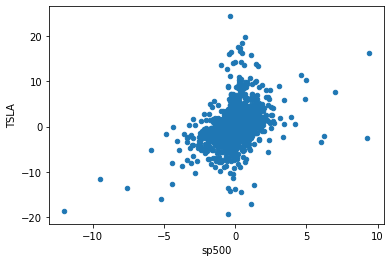

In [38]:
daily_return.plot(kind = 'scatter', x = 'sp500', y = 'TSLA')

In [39]:
beta, alpha = np.polyfit(daily_return['sp500'], daily_return['TSLA'], 1)
print(beta, alpha)

1.2686150101095912 0.1758349216516585


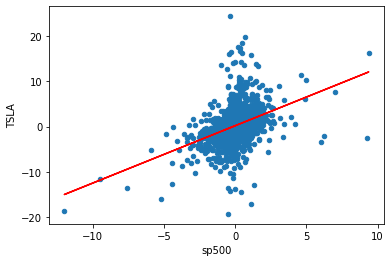

In [40]:
daily_return.plot(kind = 'scatter', x = 'sp500', y = 'TSLA')
plt.plot(daily_return['sp500'], beta*daily_return['sp500'] + alpha, '-', color='r')

In [41]:
rm = daily_return['sp500'].mean() * 252 #Total Trading Days in a Year
rm

12.42763366329808

In [42]:
rf = 0
ER_TSLA = rf + (beta * (rm-rf))

In [43]:
ER_TSLA

15.76588260540319

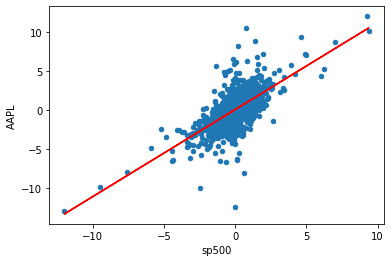

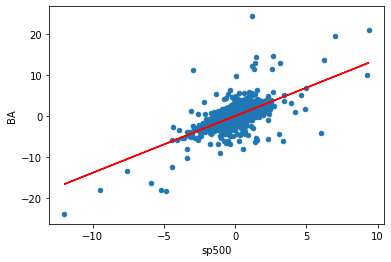

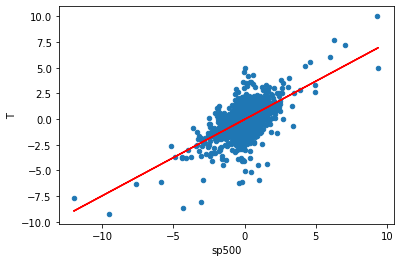

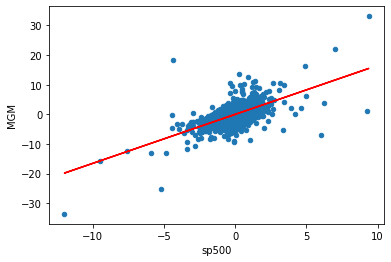

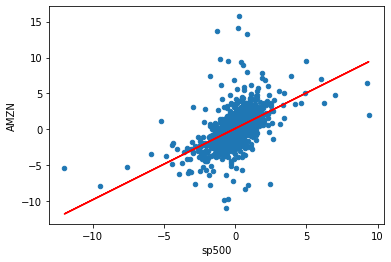

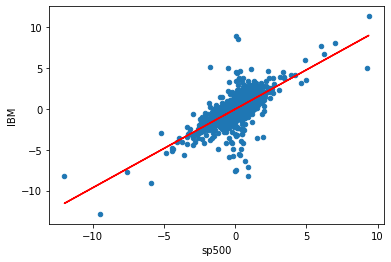

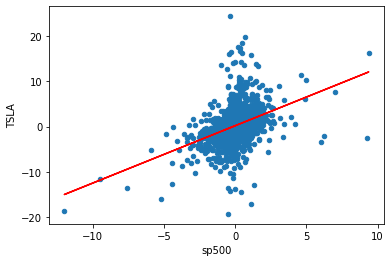

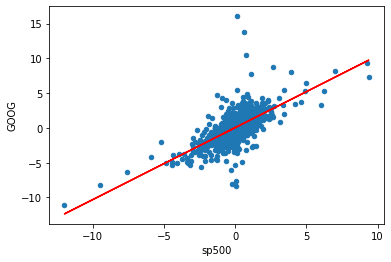

In [44]:
# Let's create a placeholder for all betas and alphas (empty dictionaries)
beta = {}
alpha = {}

# Loop on every stock daily return
for i in daily_return.columns:

  # Ignoring the date and S&P500 Columns 
  if i != 'Date' and i != 'sp500':
    # plot a scatter plot between each individual stock and the S&P500 (Market)
    daily_return.plot(kind = 'scatter', x = 'sp500', y = i)
    
    # Fit a polynomial between each stock and the S&P500 (Poly with order = 1 is a straight line)
    b, a = np.polyfit(daily_return['sp500'], daily_return[i], 1)
    
    plt.plot(daily_return['sp500'], b * daily_return['sp500'] + a, '-', color = 'r')
    
    beta[i] = b
    
    alpha[i] = a
    
    plt.show()

In [45]:
beta

{'AAPL': 1.1128924148678103,
 'BA': 1.3828672010892789,
 'T': 0.744629345474785,
 'MGM': 1.6535677065180125,
 'AMZN': 0.9917345712576852,
 'IBM': 0.9604149148095252,
 'TSLA': 1.2686150101095912,
 'GOOG': 1.0348817687428564}

In [46]:
# Let's view alpha for each of the stocks
# Alpha describes the strategy's ability to beat the market (S&P500)
# Alpha indicates the “excess return” or “abnormal rate of return,” 
# A positive 0.175 alpha for Tesla means that the portfolio’s return exceeded the benchmark S&P500 index by 17%.

alpha

{'AAPL': 0.052812084694402794,
 'BA': -0.002290698329753476,
 'T': -0.028563430198461717,
 'MGM': -0.016885305520478802,
 'AMZN': 0.10221396417765215,
 'IBM': -0.05345494150445125,
 'TSLA': 0.1758349216516585,
 'GOOG': 0.03335558721467003}

In [47]:
for i in daily_return.columns:

  # Ignoring the date and S&P500 Columns 
  if i != 'Date' and i != 'sp500':
        fig = px.scatter(x=daily_return['sp500'], y=daily_return[i], title=i)
        fig.add_scatter(x=daily_return['sp500'], y = beta[i]*daily_return['sp500'] + alpha[i])
        fig.show()

In [48]:
ER = {}

for i in beta.keys():
    ER[i] = rf + ( beta[i] * (rm-rf) )

ER

{'AAPL': 13.830619238640292,
 'BA': 17.185766980127916,
 'T': 9.253980720502053,
 'MGM': 20.549933694065853,
 'AMZN': 12.324913942818496,
 'IBM': 11.935684726020414,
 'TSLA': 15.76588260540319,
 'GOOG': 12.861131506762181}

# Machine Learning to Predict Stock Prices

In [49]:
stock_vol_df = pd.read_csv('stock_volume.csv')
stock_vol_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,53146800,3934500,26511100,17891100,5385800,6881000,729300,3764400,4019890000
1,2012-01-13,56505400,4641100,22096800,16621800,4753500,5279200,5500400,4631800,3692370000
2,2012-01-17,60724300,3700100,23500200,15480800,5644500,6003400,4651600,3832800,4010490000
3,2012-01-18,69197800,4189500,22015000,18387600,7473500,4600600,1260200,5544000,4096160000
4,2012-01-19,65434600,5397300,25524000,14022900,7096000,8567200,1246300,12657800,4465890000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,30498000,46551000,22991700,18914200,3930000,3675400,4978000,1979500,4732220000
2155,2020-08-06,50607200,32921600,21908700,35867700,3940600,3417100,5992300,1995400,4267490000
2156,2020-08-07,49453300,19301600,30398500,34530300,3929600,3651000,8883500,1576600,4104860000
2157,2020-08-10,53100900,35857700,35514400,71219700,3167300,3968300,7522300,1289300,4318570000


In [50]:
stock_vol_df = stock_vol_df.sort_values(by = ['Date'])

In [51]:
stock_vol_df.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [52]:
stock_vol_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Date    2159 non-null   object
 1   AAPL    2159 non-null   int64 
 2   BA      2159 non-null   int64 
 3   T       2159 non-null   int64 
 4   MGM     2159 non-null   int64 
 5   AMZN    2159 non-null   int64 
 6   IBM     2159 non-null   int64 
 7   TSLA    2159 non-null   int64 
 8   GOOG    2159 non-null   int64 
 9   sp500   2159 non-null   int64 
dtypes: int64(9), object(1)
memory usage: 185.5+ KB


In [53]:
stock_vol_df.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03
mean,5.820332e+07,6.419916e+06,2.832131e+07,9.845582e+06,4.102673e+06,4.453090e+06,7.001302e+06,2.498238e+06,3.680732e+09
std,4.568141e+07,9.711873e+06,1.428911e+07,7.295753e+06,2.290722e+06,2.462811e+06,5.781208e+06,1.928407e+06,8.622717e+08
min,1.136200e+07,7.889000e+05,6.862400e+06,9.507000e+05,8.813000e+05,1.193000e+06,3.649000e+05,7.900000e+03,1.248960e+09
25%,2.769930e+07,3.031850e+06,2.002150e+07,5.796450e+06,2.675700e+06,3.111250e+06,3.433450e+06,1.325400e+06,3.211890e+09
50%,4.209420e+07,3.991000e+06,2.485930e+07,7.899800e+06,3.494800e+06,3.825000e+06,5.581100e+06,1.813900e+06,3.526890e+09
75%,7.182480e+07,5.325900e+06,3.210565e+07,1.104055e+07,4.768150e+06,4.937300e+06,8.619550e+06,3.245350e+06,3.933290e+09
max,3.765300e+08,1.032128e+08,1.950827e+08,9.009820e+07,2.385610e+07,3.049020e+07,6.093880e+07,2.497790e+07,9.044690e+09


In [54]:
interactive_plot(stock_vol_df, 'Volume of Stocks')

In [55]:
interactive_plot(Normalize(stock_vol_df), 'Normalized Volume of Stocks')

In [56]:
# Function to concatenate the date, stock price, and volume in one dataframe
def individual_stock(price_df, vol_df, name):
    return pd.DataFrame({'Date': price_df['Date'], 'Close': price_df[name], 'Volume': vol_df[name]})

In [57]:
# Function to return the input/output (target) data for AI/ML Model
# Note that our goal is to predict the future stock price 
# Target stock price today will be tomorrow's price 
def trading_window(data):
  
  # 1 day window 
  n = 1

  # Create a column containing the prices for the next 1 days
  data['Target'] = data[['Close']].shift(-n)
  
  # return the new dataset 
  return data

In [58]:
# Let's test the functions and get individual stock prices and volumes for AAPL
price_volume_df = individual_stock(stocks_df, stock_vol_df, 'AAPL')
price_volume_df

,Date,Close,Volume
0,2012-01-12,60.198570,53146800
1,2012-01-13,59.972858,56505400
2,2012-01-17,60.671429,60724300
3,2012-01-18,61.301430,69197800
4,2012-01-19,61.107143,65434600
...,...,...,...
2154,2020-08-05,440.250000,30498000
2155,2020-08-06,455.609985,50607200
2156,2020-08-07,444.450012,49453300
2157,2020-08-10,450.910004,53100900


In [59]:
price_volume_target_df = trading_window(price_volume_df)
price_volume_target_df

,Date,Close,Volume,Target
0,2012-01-12,60.198570,53146800,59.972858
1,2012-01-13,59.972858,56505400,60.671429
2,2012-01-17,60.671429,60724300,61.301430
3,2012-01-18,61.301430,69197800,61.107143
4,2012-01-19,61.107143,65434600,60.042858
...,...,...,...,...
2154,2020-08-05,440.250000,30498000,455.609985
2155,2020-08-06,455.609985,50607200,444.450012
2156,2020-08-07,444.450012,49453300,450.910004
2157,2020-08-10,450.910004,53100900,437.500000


In [60]:
# Remove the last row as it will be a null value
price_volume_target_df = price_volume_target_df[:-1]
price_volume_target_df

,Date,Close,Volume,Target
0,2012-01-12,60.198570,53146800,59.972858
1,2012-01-13,59.972858,56505400,60.671429
2,2012-01-17,60.671429,60724300,61.301430
3,2012-01-18,61.301430,69197800,61.107143
4,2012-01-19,61.107143,65434600,60.042858
...,...,...,...,...
2153,2020-08-04,438.660004,43267900,440.250000
2154,2020-08-05,440.250000,30498000,455.609985
2155,2020-08-06,455.609985,50607200,444.450012
2156,2020-08-07,444.450012,49453300,450.910004


In [61]:
# Scale the data
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
price_volume_target_scaled_df = sc.fit_transform(price_volume_target_df.drop(columns = ['Date']))

In [62]:
price_volume_target_scaled_df

array([[0.01102638, 0.11442624, 0.01046185],
       [0.01046185, 0.12362365, 0.01220906],
       [0.01220906, 0.13517696, 0.01378478],
       ...,
       [1.        , 0.10747163, 0.97208751],
       [0.97208751, 0.10431171, 0.98824476],
       [0.98824476, 0.11430054, 0.95470465]])

In [63]:
# Creating Feature and Target
X = price_volume_target_scaled_df[:,:2]
y = price_volume_target_scaled_df[:,2:]

In [64]:
# Spliting the data this way, since order is important in time-series
# We did not use train test split with it's default settings since it shuffles the data
split = int(0.65 * len(X))
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

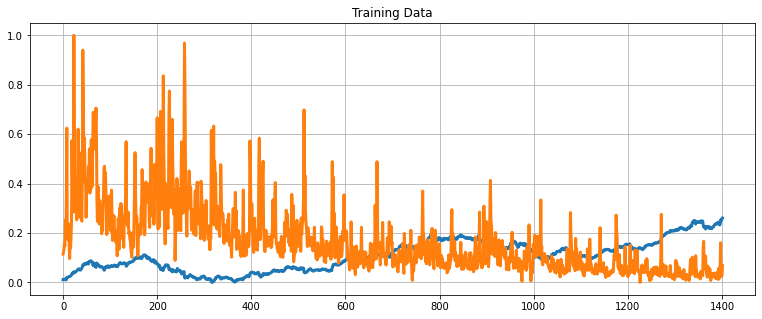

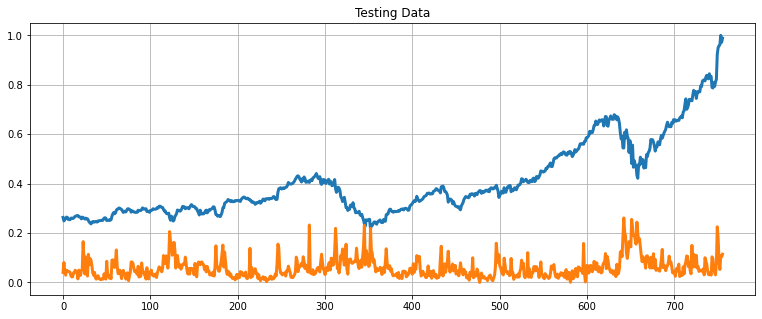

In [65]:
# Define a data plotting function
def show_plot(data, title):
  plt.figure(figsize = (13, 5))
  plt.plot(data, linewidth = 3)
  plt.title(title)
  plt.grid()

show_plot(X_train, 'Training Data')
show_plot(X_test, 'Testing Data')

## BUILD AND TRAIN A RIDGE LINEAR REGRESSION MODEL

In [66]:
from sklearn.linear_model import Ridge
# Note that Ridge regression performs linear least squares with L2 regularization.
# Create and train the Ridge Linear Regression  Model
model = Ridge(alpha=1)
model.fit(X_train, y_train)

Ridge(alpha=1)

In [67]:
# Test the model and calculate its accuracy 
lr_accuracy = model.score(X_test, y_test)
print("Linear Regression Score: ", lr_accuracy)

Linear Regression Score:  0.7950028030821767


In [68]:
# Make Prediction
predicted_prices = model.predict(X)
predicted_prices

array([[0.03466412],
       [0.03374627],
       [0.03451936],
       ...,
       [0.81048342],
       [0.78876033],
       [0.80091324]])

In [69]:
len(predicted_prices)

2158

In [70]:
# Append the close values to the list
close = []
for i in price_volume_target_scaled_df:
  close.append(i[0])

In [71]:
# Create a dataframe based on the dates in the individual stock data
df_predicted = price_volume_target_df[['Date']]
df_predicted

,Date
0,2012-01-12
1,2012-01-13
2,2012-01-17
3,2012-01-18
4,2012-01-19
...,...
2153,2020-08-04
2154,2020-08-05
2155,2020-08-06
2156,2020-08-07


In [72]:
# Add the close values to the dataframe
df_predicted['Close'] = close
df_predicted

,Date,Close
0,2012-01-12,0.011026
1,2012-01-13,0.010462
2,2012-01-17,0.012209
3,2012-01-18,0.013785
4,2012-01-19,0.013299
...,...,...
2153,2020-08-04,0.957606
2154,2020-08-05,0.961583
2155,2020-08-06,1.000000
2156,2020-08-07,0.972088


In [73]:
# Add the predicted values to the dataframe
df_predicted['Prediction'] = predicted_prices
df_predicted

,Date,Close,Prediction
0,2012-01-12,0.011026,0.034664
1,2012-01-13,0.010462,0.033746
2,2012-01-17,0.012209,0.034519
3,2012-01-18,0.013785,0.034556
4,2012-01-19,0.013299,0.034707
...,...,...,...
2153,2020-08-04,0.957606,0.778280
2154,2020-08-05,0.961583,0.783205
2155,2020-08-06,1.000000,0.810483
2156,2020-08-07,0.972088,0.788760


In [74]:
# Plot the results
interactive_plot(df_predicted, "Original Vs. Prediction")

# TRAIN AN LSTM TIME SERIES MODEL

In [75]:
# Let's test the functions and get individual stock prices and volumes for AAPL
price_volume_df = individual_stock(stocks_df, stock_vol_df, 'AAPL')
price_volume_df

,Date,Close,Volume
0,2012-01-12,60.198570,53146800
1,2012-01-13,59.972858,56505400
2,2012-01-17,60.671429,60724300
3,2012-01-18,61.301430,69197800
4,2012-01-19,61.107143,65434600
...,...,...,...
2154,2020-08-05,440.250000,30498000
2155,2020-08-06,455.609985,50607200
2156,2020-08-07,444.450012,49453300
2157,2020-08-10,450.910004,53100900


In [76]:
# Get the close and volume data as training data (Input)
training_data = price_volume_df.iloc[:, 1:3].values
training_data

array([[6.01985700e+01, 5.31468000e+07],
       [5.99728580e+01, 5.65054000e+07],
       [6.06714290e+01, 6.07243000e+07],
       ...,
       [4.44450012e+02, 4.94533000e+07],
       [4.50910004e+02, 5.31009000e+07],
       [4.37500000e+02, 4.68711000e+07]])

In [77]:
# Normalize the data
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_data)

In [78]:
# Creating the training and testing data, training data contains present day and previous day values
X = []
y = []
for i in range(1, len(price_volume_df)):
    X.append(training_set_scaled [i-1:i, 0])
    y.append(training_set_scaled [i, 0])

In [79]:
X

[array([0.01102638]),
 array([0.01046185]),
 array([0.01220906]),
 array([0.01378478]),
 array([0.01329884]),
 array([0.01063693]),
 array([0.01317736]),
 array([0.01067623]),
 array([0.02005545]),
 array([0.01933012]),
 array([0.02027698]),
 array([0.02232433]),
 array([0.02356417]),
 array([0.02346055]),
 array([0.02307824]),
 array([0.02470754]),
 array([0.02624037]),
 array([0.02797688]),
 array([0.03078171]),
 array([0.03667365]),
 array([0.03676297]),
 array([0.04004303]),
 array([0.04249412]),
 array([0.0382815]),
 array([0.03990367]),
 array([0.03987152]),
 array([0.04442]),
 array([0.04377327]),
 array([0.04497023]),
 array([0.0471212]),
 array([0.04831818]),
 array([0.05176615]),
 array([0.054278]),
 array([0.05500331]),
 array([0.05525701]),
 array([0.05096223]),
 array([0.04992603]),
 array([0.05007968]),
 array([0.0541172]),
 array([0.05525344]),
 array([0.05769381]),
 array([0.06344641]),
 array([0.07112129]),
 array([0.06968493]),
 array([0.0696885]),
 array([0.07523743]

In [80]:
# Convert the data into array format
X = np.asarray(X)
y = np.asarray(y)

In [81]:
# Split the data
split = int(0.7 * len(X))
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

In [82]:
# Reshape the 1D arrays to 3D arrays to feed in the model
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_train.shape, X_test.shape

((1510, 1, 1), (648, 1, 1))

In [83]:
X_train

array([[[0.01102638]],

       [[0.01046185]],

       [[0.01220906]],

       ...,

       [[0.29648343]],

       [[0.29638336]],

       [[0.29885949]]])

In [84]:
# Create the model
inputs = keras.layers.Input(shape=(X_train.shape[1], X_train.shape[2]))
x = keras.layers.LSTM(150, return_sequences= True)(inputs)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150, return_sequences=True)(x)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150)(x)
outputs = keras.layers.Dense(1, activation='linear')(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.compile(optimizer='adam', loss="mse")
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 1)]            0         
_________________________________________________________________
lstm (LSTM)                  (None, 1, 150)            91200     
_________________________________________________________________
dropout (Dropout)            (None, 1, 150)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 1, 150)            180600    
_________________________________________________________________
dropout_1 (Dropout)          (None, 1, 150)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 150)               180600    
_________________________________________________________________
dense (Dense)                (None, 1)                 151   

In [85]:
# Train the model
history = model.fit(
    X_train, y_train,
    epochs = 20,
    batch_size = 32,
    validation_split = 0.3
)

Epoch 1/20
34/34 [==============================] - 17s 163ms/step - loss: 0.0059 - val_loss: 0.0143
Epoch 2/20
34/34 [==============================] - 1s 17ms/step - loss: 0.0024 - val_loss: 0.0059
Epoch 3/20
34/34 [==============================] - 1s 17ms/step - loss: 7.1378e-04 - val_loss: 1.0457e-04
Epoch 4/20
34/34 [==============================] - 1s 15ms/step - loss: 7.1816e-05 - val_loss: 1.5777e-05
Epoch 5/20
34/34 [==============================] - 1s 19ms/step - loss: 5.2904e-05 - val_loss: 1.5328e-05
Epoch 6/20
34/34 [==============================] - 1s 19ms/step - loss: 4.1836e-05 - val_loss: 1.7369e-05
Epoch 7/20
34/34 [==============================] - 1s 17ms/step - loss: 5.8291e-05 - val_loss: 2.2533e-05
Epoch 8/20
34/34 [==============================] - 1s 16ms/step - loss: 6.4723e-05 - val_loss: 1.0383e-04
Epoch 9/20
34/34 [==============================] - 1s 17ms/step - loss: 8.4181e-05 - val_loss: 2.2126e-05
Epoch 10/20
34/34 [==============================] 

In [86]:
# Make prediction
predicted = model.predict(X)

In [87]:
df_predicted = price_volume_df[1:][['Date']]
df_predicted

,Date
1,2012-01-13
2,2012-01-17
3,2012-01-18
4,2012-01-19
5,2012-01-20
...,...
2154,2020-08-05
2155,2020-08-06
2156,2020-08-07
2157,2020-08-10


In [88]:
df_predicted['predictions'] = predicted

In [89]:
df_predicted

,Date,predictions
1,2012-01-13,0.014870
2,2012-01-17,0.014322
3,2012-01-18,0.016019
4,2012-01-19,0.017550
5,2012-01-20,0.017078
...,...,...
2154,2020-08-05,0.927812
2155,2020-08-06,0.931425
2156,2020-08-07,0.966147
2157,2020-08-10,0.940950


In [90]:
# Plot the data
close = []
for i in training_set_scaled:
  close.append(i[0])

In [91]:
df_predicted['Close'] = close[1:]

In [92]:
df_predicted

,Date,predictions,Close
1,2012-01-13,0.014870,0.010462
2,2012-01-17,0.014322,0.012209
3,2012-01-18,0.016019,0.013785
4,2012-01-19,0.017550,0.013299
5,2012-01-20,0.017078,0.010637
...,...,...,...
2154,2020-08-05,0.927812,0.961583
2155,2020-08-06,0.931425,1.000000
2156,2020-08-07,0.966147,0.972088
2157,2020-08-10,0.940950,0.988245


In [93]:
# Plot the data
interactive_plot(df_predicted, "Original Vs Prediction")